In [1]:
from pygradu import gridify
import shapely.geometry
import pandas as pd
import numpy as np
import importlib

grid = gridify.area_to_grid(side_length=10000)

Original NE: POINT (31.5 66.8)
Original SW: POINT (8.5 53)
Transformed NE: (697681.2863658136, 7416224.9393330095)
Transformed SW: (-735260.4063631196, 6033964.466017238)
col_count 143
row_count 138
grid_size 19734


In [2]:
ais = pd.read_csv('test_set.csv', parse_dates = ['timestamp'])
ais.head()

,Unnamed: 0,timestamp,mmsi,lat,lon,speed,course,heading,turnrate,vessel_id,vessel_src,imo,breadth,vessel_type,vessel_max_speed,draft,power,length,dwt,iceclass
0,0,2019-05-11 00:00:01,219002177,54.935935,11.371978,0.00,127.0,NaN,0.0,9091143,9,9257632.0,13.00,PAS,10.0,2.50,736.0,55.00,80.0,NaN
1,1,2019-05-11 00:00:01,246578000,58.622062,16.247602,0.00,227.4,297.0,0.0,9159458,9,9387322.0,12.52,GC,10.5,5.40,1521.0,88.60,3850.0,II
2,2,2019-05-11 00:00:01,257555000,59.708815,21.297042,4.53,343.6,344.0,0.0,9042673,9,9356622.0,23.00,T,14.0,8.40,6300.0,144.05,17006.0,IA
3,3,2019-05-11 00:00:01,276779000,59.773905,20.321385,8.54,298.0,297.0,0.0,8891012,9,9443255.0,29.00,PAS,22.0,6.40,27200.0,212.00,6287.0,IAS
4,6,2019-05-11 00:00:02,215462000,58.158333,20.412333,6.28,205.0,204.0,0.0,7832395,9,9255842.0,32.03,T,14.7,10.02,9467.0,180.00,37379.0,II


In [3]:
ais_subset = ais[['timestamp', 'mmsi', 'lat', 'lon', 'speed', 'course', 'vessel_type']]

In [4]:
len(ais_subset)

7598831

In [5]:
ais_subset.head(10)

,timestamp,mmsi,lat,lon,speed,course,vessel_type
0,2019-05-11 00:00:01,219002177,54.935935,11.371978,0.00,127.0,PAS
1,2019-05-11 00:00:01,246578000,58.622062,16.247602,0.00,227.4,GC
2,2019-05-11 00:00:01,257555000,59.708815,21.297042,4.53,343.6,T
3,2019-05-11 00:00:01,276779000,59.773905,20.321385,8.54,298.0,PAS
4,2019-05-11 00:00:02,215462000,58.158333,20.412333,6.28,205.0,T
5,2019-05-11 00:00:02,249928000,57.489290,11.393607,4.99,312.1,GC
6,2019-05-11 00:00:02,636013276,55.753218,18.916790,0.10,234.8,T
7,2019-05-11 00:00:03,229015000,54.578970,11.180610,6.33,118.3,T
8,2019-05-11 00:00:03,265177000,57.551692,11.180502,10.39,246.0,PAS
9,2019-05-11 00:00:03,265520420,59.329213,18.074755,0.00,331.2,PAS


In [6]:
%time ais_subset.head(10).speed.iloc[::-1].rolling(3).sum().iloc[::-1]

CPU times: user 1.9 ms, sys: 932 µs, total: 2.83 ms
Wall time: 3.98 ms


0     4.53
1    13.07
2    19.35
3    19.81
4    11.37
5    11.42
6    16.82
7    16.72
8      NaN
9      NaN
Name: speed, dtype: float64

In [7]:
%time ais_subset['grid_point'] = ais_subset.apply(lambda row: grid.get_grid_point(row.lat, row.lon), axis=1)
%time ais_subset['node'] = ais_subset.apply(lambda row: grid.get_grid_position(row), axis=1)

/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  """Entry point for launching an IPython kernel.


CPU times: user 4min 17s, sys: 4.79 s, total: 4min 22s
Wall time: 4min 24s
CPU times: user 5min 28s, sys: 16.3 s, total: 5min 45s
Wall time: 6min 12s


/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  """Entry point for launching an IPython kernel.


In [8]:
ports = pd.read_csv('data/ports.csv')
ports = ports[['port_id', 'lat', 'lon']]
ports.head()

,port_id,lat,lon
0,3108059,60.6167,28.5667
1,3108062,59.6833,28.4000
2,3108065,59.5833,25.7000
3,3108068,59.4833,24.9500
4,3108071,59.5167,26.5333


In [9]:
ais_ports = pd.read_csv('ports_calculated_from_ais.csv')
ais_ports = ais_ports[['id', 'lat', 'lon']]
ais_ports.head()

,id,lat,lon
0,25182,57.689202,11.847573
1,6653,54.381692,10.178677
2,6652,54.366730,10.131996
3,35663,59.258447,10.491923
4,27668,58.087629,11.811959


In [10]:
%time ais_ports['grid_point'] = ais_ports.apply(lambda row: grid.get_grid_point(row.lat, row.lon), axis=1)
%time ais_ports['node'] = ais_ports.apply(lambda row: grid.get_grid_position(row), axis=1)

CPU times: user 26.2 ms, sys: 520 µs, total: 26.8 ms
Wall time: 26.9 ms
CPU times: user 5.2 ms, sys: 759 µs, total: 5.96 ms
Wall time: 5.3 ms


In [11]:
%time ports['grid_point'] = ports.apply(lambda row: grid.get_grid_point(row.lat, row.lon), axis=1)
%time ports['node'] = ports.apply(lambda row: grid.get_grid_position(row), axis=1)

CPU times: user 25.4 ms, sys: 939 µs, total: 26.4 ms
Wall time: 25.8 ms
CPU times: user 8.15 ms, sys: 1.5 ms, total: 9.64 ms
Wall time: 8.39 ms


In [12]:
ports.head()

,port_id,lat,lon,grid_point,node
0,3108059,60.6167,28.5667,"(585749.8580706033, 6721116.533569696)",9514
1,3108062,59.6833,28.4000,"(578830.0488743888, 6616973.335420567)",7996
2,3108065,59.5833,25.7000,"(426582.1604860736, 6605724.049814608)",7843
3,3108068,59.4833,24.9500,"(383889.44671323925, 6595659.5000159)",7700
4,3108071,59.5167,26.5333,"(473589.9569657229, 6597681.854586878)",7709


In [13]:
ports_subset = ports[['port_id', 'node']]
ports_subset[ports_subset.port_id == 941].head()

,port_id,node
28,941,8805


In [14]:
ports_subset = ports_subset.set_index('node')

ports_dict = ports_subset.to_dict()
ports_dict = ports_dict['port_id']

In [15]:
ais_ports.head()

,id,lat,lon,grid_point,node
0,25182,57.689202,11.847573,"(-398785.26567935024, 6495482.517659897)",6243
1,6653,54.381692,10.178677,"(-587275.2318693928, 6157321.487619004)",1670
2,6652,54.366730,10.131996,"(-590666.4141463246, 6156416.6358715715)",1670
3,35663,59.258447,10.491923,"(-434957.8675338336, 6685827.309428675)",8861
4,27668,58.087629,11.811959,"(-390837.06829205586, 6539616.887929373)",6934


In [16]:
ais_ports_subset = ais_ports[['id', 'node']]
ais_ports_subset = ais_ports_subset.set_index('node')

ais_ports_dict = ais_ports_subset.to_dict()
ais_ports_dict = ais_ports_dict['id']

#ais_ports_dict

In [17]:
ports_dict.update(ais_ports_dict)

In [18]:
1996 in ports_dict

False

In [19]:
1534 in ports_dict

False

In [20]:
ais_subset = ais_subset.sort_values(by=['mmsi', 'timestamp'])
ais_subset = ais_subset.reset_index(drop=True)

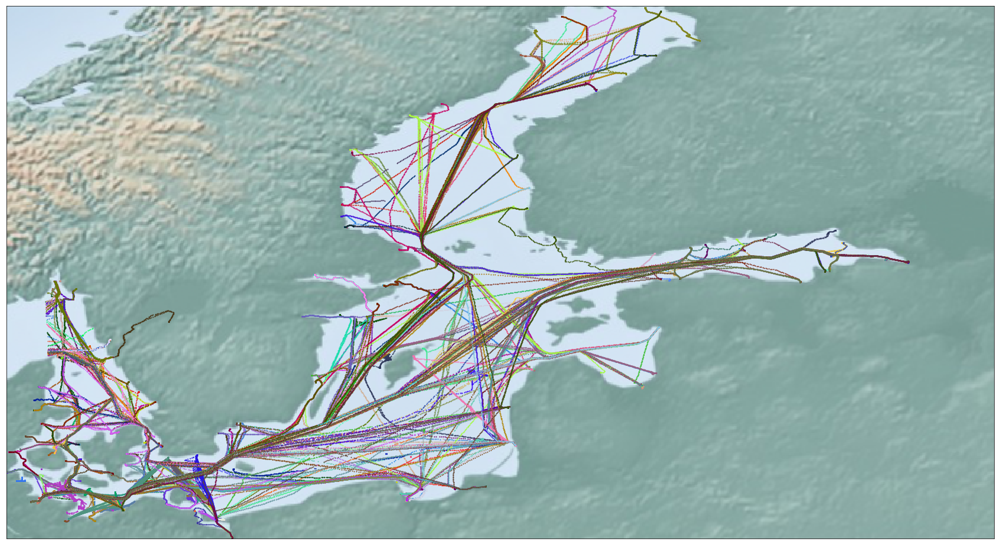

In [21]:
test = ais_subset[(ais_subset.mmsi == 276807000) | (ais_subset.mmsi == 265004000)]
test = ais_subset[ais_subset.mmsi == 205453000]
#test = ais_subset[ais_subset.lat > 58].head(100000)
test = ais_subset.head(500000)
# plot all AIS
import matplotlib.pyplot as plt
%matplotlib inline 
from mpl_toolkits.basemap import Basemap  # import Basemap matplotlib toolkit


test = test.reset_index(drop=True)
test = test.sort_values(by=['mmsi', 'timestamp'])

observations_by_vessels = test.groupby('mmsi')

graph = []

fig = plt.figure(figsize=(30,30))

m = Basemap(llcrnrlon = ais.lon.min(),llcrnrlat = ais.lat.min(), urcrnrlon = ais.lon.max(),
           urcrnrlat = ais.lat.max(),
           resolution='h')
m.shadedrelief()
for mmsi, observations in observations_by_vessels:
    xy = observations.loc[:, ('lat', 'lon')]
    plt.plot(xy.loc[:, ('lon')], xy.loc[:, ('lat')], 'o', c=np.random.rand(3,), alpha=1, markersize=1)
plt.show()

In [21]:
#test[test.node == 1917]
#test[test.node == 2193]
#ais_subset.head(10000)

In [23]:
from pygradu import portcalls
importlib.reload(portcalls) 

%time voyages = portcalls.calculate_voyages(ais_subset, ports_dict)

/Users/villehak/hobbies/gradu/pygradu/portcalls.py:158: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  observations['long_speed'] = observations.speed.iloc[::-1].rolling(3).mean().iloc[::-1]
/Users/villehak/hobbies/gradu/pygradu/portcalls.py:159: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  observations['really_long_speed'] = observations.speed.iloc[::-1].rolling(5).mean().iloc[::-1]


i=0
i=500000
i=1000000
i=1500000
i=2000000
i=2500000
i=3000000
i=3500000
i=4000000
i=4500000
i=5000000
i=5500000
i=6000000
i=6500000
i=7000000
i=7500000
CPU times: user 2h 50min 45s, sys: 9min 31s, total: 3h 16s
Wall time: 1h 10min 9s


In [24]:
voyages.head() # len = 7598831

,timestamp,mmsi,lat,lon,speed,node,vessel_type,start_port,end_port,end_lat,end_lon,ata,atd,in_port,voyage
0,2019-05-11 22:48:59,205465000,54.049413,14.210685,5.14,453,GC,1182,6652,54.370788,10.168035,2019-05-12 19:50:58,2019-05-11 22:48:59,False,0
1,2019-05-11 22:55:58,205465000,54.067272,14.197102,5.20,453,GC,1182,6652,54.370788,10.168035,2019-05-12 19:50:58,2019-05-11 22:48:59,False,0
2,2019-05-11 23:01:58,205465000,54.082620,14.185420,5.20,453,GC,1182,6652,54.370788,10.168035,2019-05-12 19:50:58,2019-05-11 22:48:59,False,0
3,2019-05-11 23:07:59,205465000,54.097968,14.173543,5.14,453,GC,1182,6652,54.370788,10.168035,2019-05-12 19:50:58,2019-05-11 22:48:59,False,0
4,2019-05-11 23:19:59,205465000,54.128692,14.150258,5.20,591,GC,1182,6652,54.370788,10.168035,2019-05-12 19:50:58,2019-05-11 22:48:59,False,0


In [25]:
voyages.tail()

,timestamp,mmsi,lat,lon,speed,node,vessel_type,start_port,end_port,end_lat,end_lon,ata,atd,in_port,voyage
923267,2019-05-28 10:22:26,636092741,54.365418,10.166105,1.34,1670,CONT,16217,6652,54.36536,10.144115,2019-05-28 10:46:55,2019-05-23 16:02:14,True,6577
923268,2019-05-28 10:28:35,636092741,54.364170,10.159312,1.18,1670,CONT,16217,6652,54.36536,10.144115,2019-05-28 10:46:55,2019-05-23 16:02:14,True,6577
923269,2019-05-28 10:34:35,636092741,54.364028,10.152482,1.08,1670,CONT,16217,6652,54.36536,10.144115,2019-05-28 10:46:55,2019-05-23 16:02:14,True,6577
923270,2019-05-28 10:40:54,636092741,54.364933,10.146450,0.93,1670,CONT,16217,6652,54.36536,10.144115,2019-05-28 10:46:55,2019-05-23 16:02:14,True,6577
923271,2019-05-28 10:46:55,636092741,54.365360,10.144115,0.05,1670,CONT,16217,6652,54.36536,10.144115,2019-05-28 10:46:55,2019-05-23 16:02:14,True,6577


In [26]:
## Talvi
# Eka 538
# Toka 800
# Kolmas 367
len(voyages.voyage.drop_duplicates())

6578

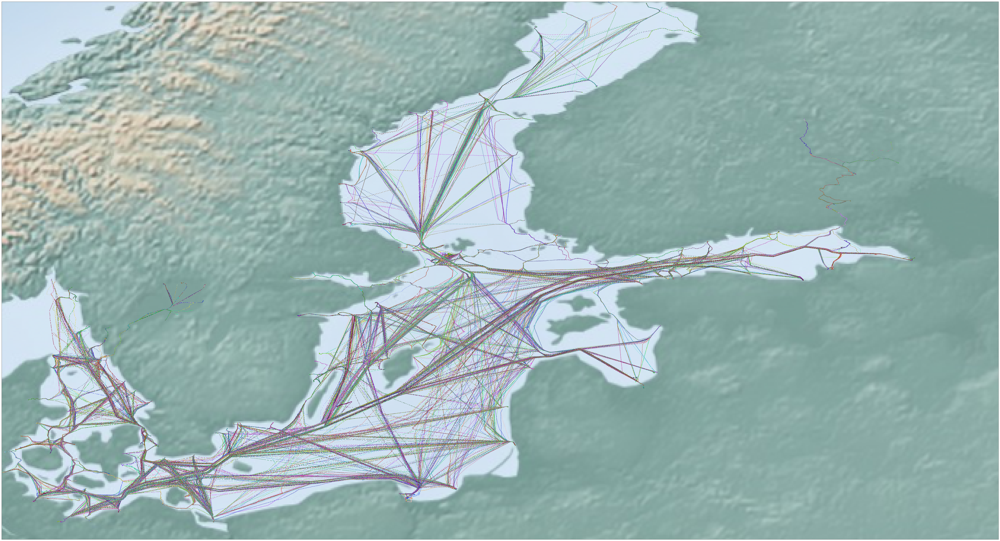

In [27]:
observations_by_voyage = voyages.groupby('voyage')

fig = plt.figure(figsize=(120,120))

m = Basemap(llcrnrlon = ais.lon.min(),llcrnrlat = ais.lat.min(), urcrnrlon = ais.lon.max(),
           urcrnrlat = ais.lat.max(),
           resolution='h')
m.shadedrelief()
for mmsi, observations in observations_by_voyage:
    xy = observations.loc[:, ('lat', 'lon')]
    plt.plot(xy.loc[:, ('lon')], xy.loc[:, ('lat')], 'o', c=np.random.rand(3,), alpha=1, markersize=2)
plt.show()

In [28]:
len(voyages[voyages.voyage == 0].mmsi)

204

In [29]:
grid.side_length

10000

In [30]:
len(voyages.mmsi)

923272

In [31]:
len(voyages.voyage.drop_duplicates())

6578

In [33]:
#voyages.to_csv('new_summer_test_voyages.csv')

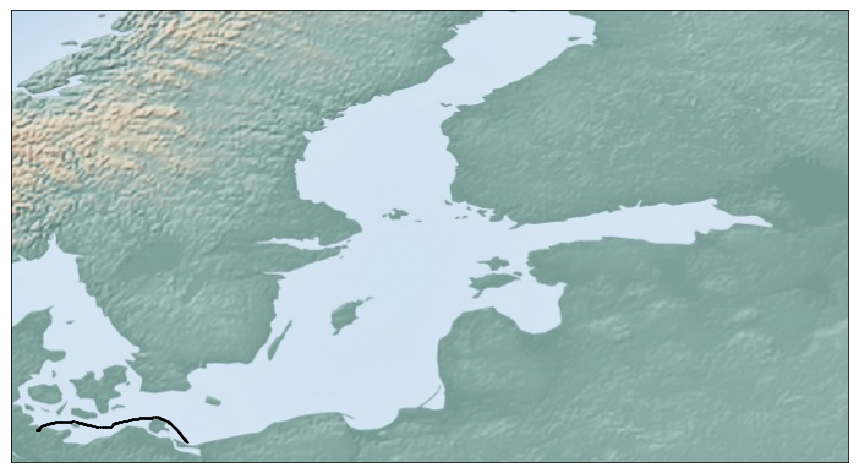

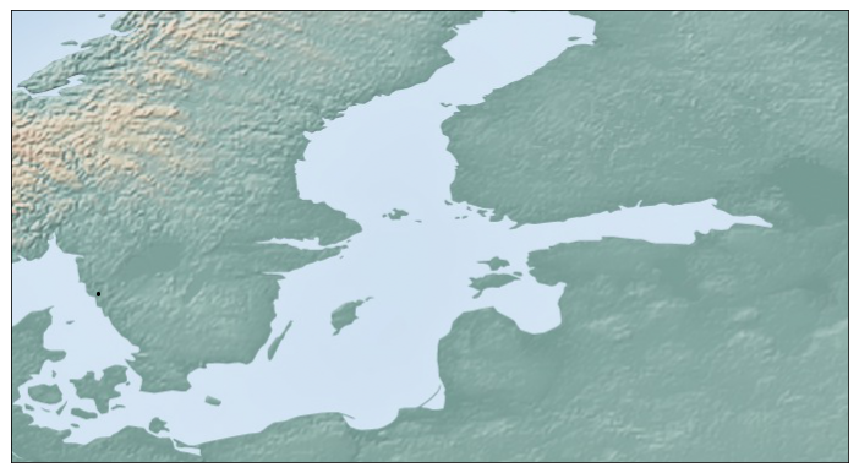

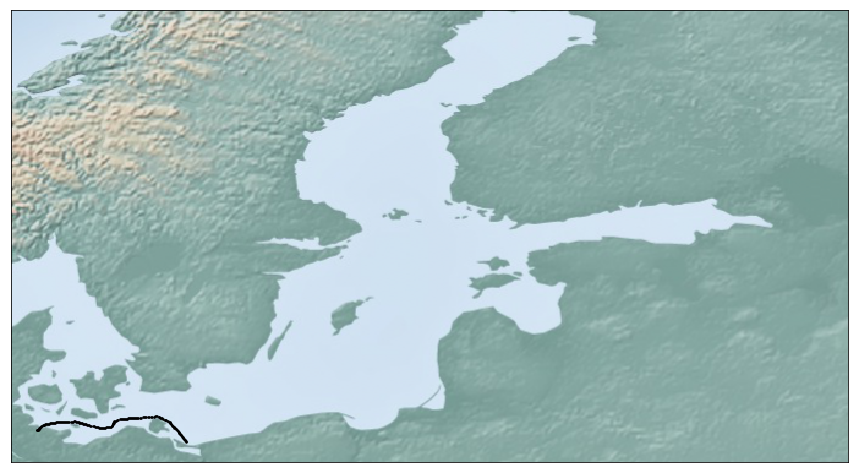

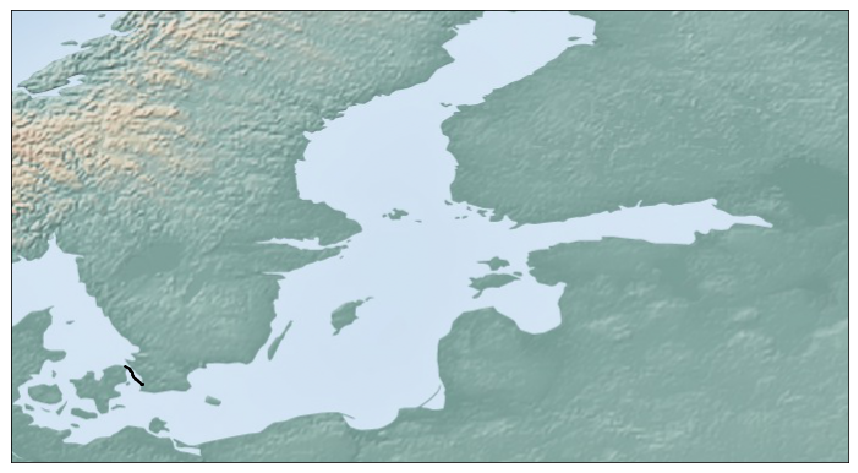

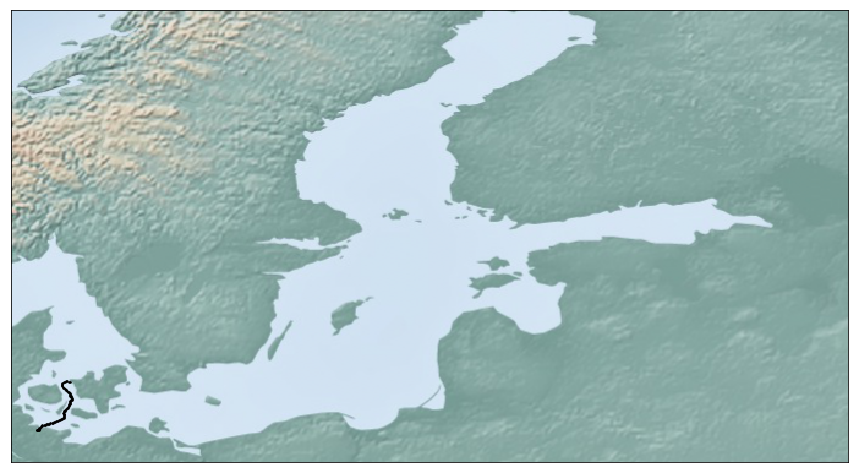

...

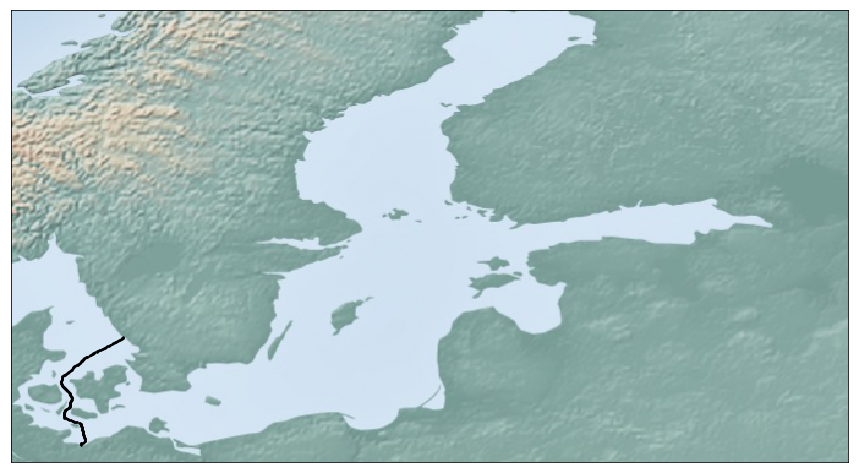

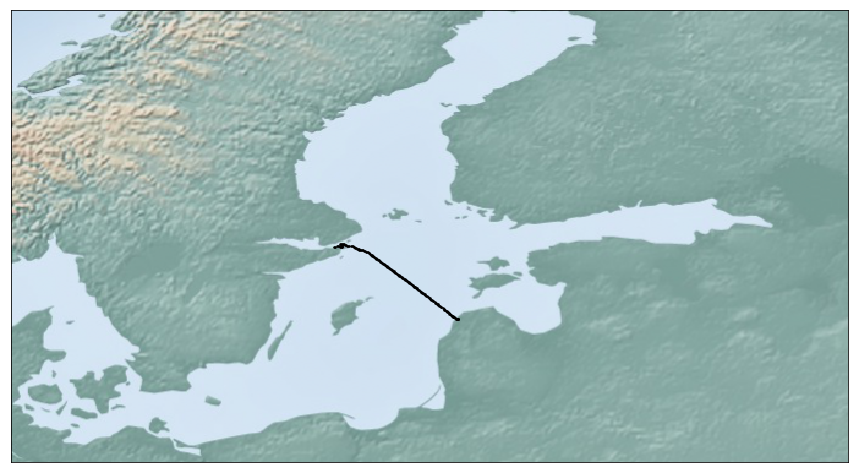

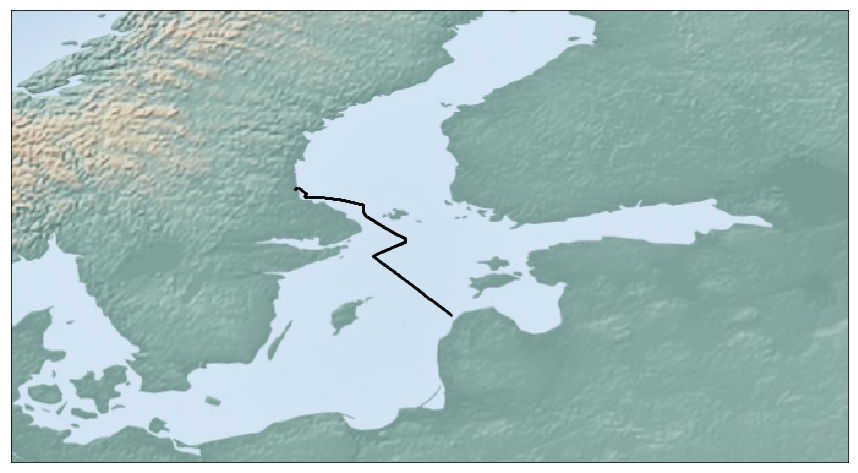

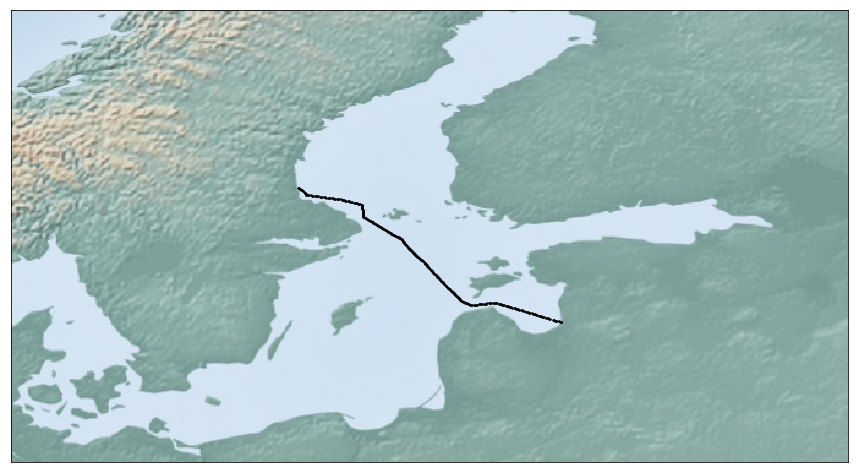

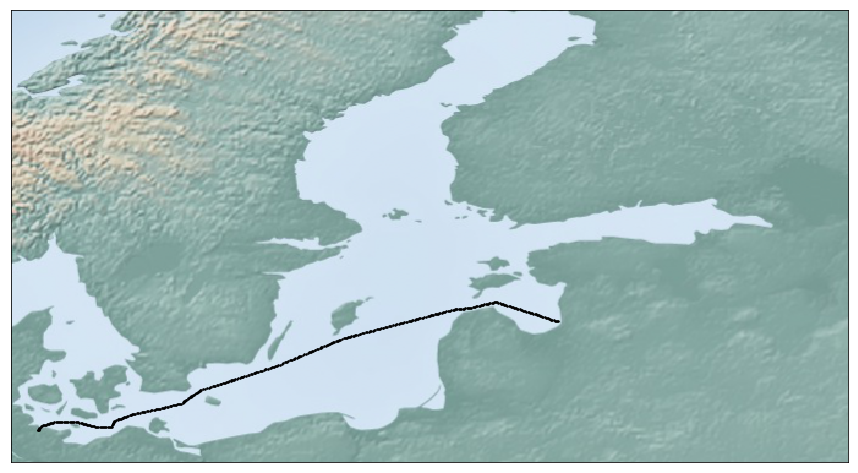

KeyboardInterrupt: 

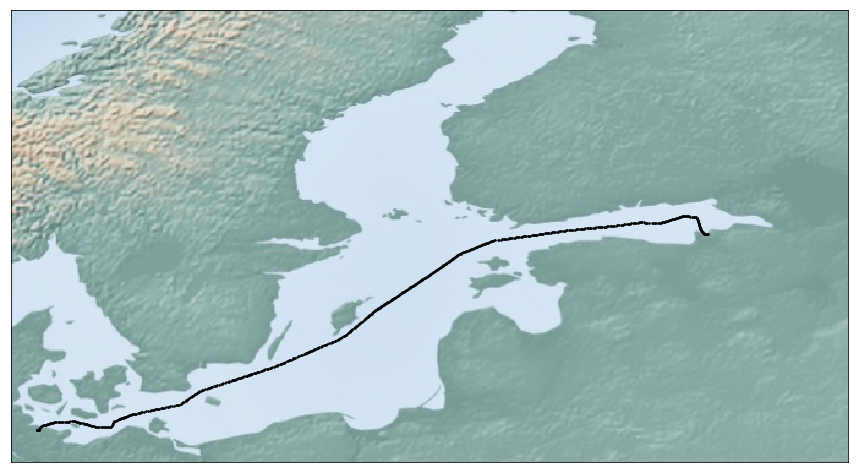

In [32]:
observations_by_voyage = voyages.groupby('voyage')

for i in range(1, 50):
    fig = plt.figure(figsize=(15,15))

    m = Basemap(llcrnrlon = ais.lon.min(),llcrnrlat = ais.lat.min(), urcrnrlon = ais.lon.max(),
               urcrnrlat = ais.lat.max(),
               resolution='h')
    m.shadedrelief()
    for mmsi, observations in observations_by_voyage:
        xy = observations[observations.voyage == i].loc[:, ('lat', 'lon')]
        plt.plot(xy.loc[:, ('lon')], xy.loc[:, ('lat')], 'o', c='black', alpha=1, markersize=1.5)
    plt.show()